<a href="https://colab.research.google.com/github/Laofin050/Praktikum-Machine-Learning/blob/main/next_(versi_3)_Kegiatan_Modul_5_Lauvin.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Soal Praktikum Overfitting Handling #3 dan #4**

## Kegiatan 1 **(Individu)** 
70 poin

**Peraturan :**
* Tidak boleh ada error dalam kode program
* Kali ini anda dibebaskan untuk memilih satu dataset untuk kasus klasifikasi citra penyakit (pada manusia, hewan atau tumbuhan) menggunakan model CNN.
* Pastikan bahwa dataset tersebut termasuk dataset Imbalance.
* Dalam modul ini tidak diperbolehkan menggunakan teknik transfer learning dari pretrain model baik yang di bangun sendiri atau anda dapatkan dari sumber lain (tensorflow, keras, dan sebagainya)
* **Disarankan menggunakan Google Colab** dengan jenis runtime **GPU**
* Perhatikan langkah demi langkah yang diperintahkan dalam kegiatan ini

### **SOAL 1 :** 
---
* Lakukan resampling dataset agar dataset anda menjadi seimbang. Anda dibebaskan menggunakan teknik resampling apapun. Jelaskan tentang cara kerja metode resampling yang anda gunakan kepada asisten
* Melakukan proses EDA sesuai dengan kondisi data yang anda gunakan. Jelaskan kepada asisten terkait temuan kondisi data anda dan cara penanganannya 
* Melakukan ujicoba model dengan menerapkan materi pada modul-modul sebelumnya. (regularization, hiperparameter tuning, lr scheduler, dll) 
* Melakuakn augmentasi data menggunakan teknik image processing seperti (random noise, clahe, usuyama, blur, atau yang lainnya) dan ImageDataGenerator
- Membangun 2 model dengan ketentuan :
 1. Model pertama menggabungkan minimal **2 kombinasi pretrained architectures** yang berbeda sebagai ekstraksi fitur. Training pembobotan dilakukan pada layer eksperiment dengan menerapkan improvisasi training pada modul sebelumnya. Referensi pretrained arsitektur yang terdapat pada keras dapat anda lihat di laman berikut: https://www.tensorflow.org/api_docs/python/tf/keras/applications
 2. Model kedua menggunakan sebuah pretrained model bebas dengan improvisasi anda sendiri. Anda dapat menggunakan improvisasi pada modul sebelumnya dengan menggunakan dropout, regulizer, early stopping, callback training, grid search, dsb.
* Setiap model dilatih dengan jumlah epoch minimal 150 epoch dan output layer wajib menggunakan `softmax`.
* Membuat evaluasi model berupa plot nilai akurasi dan loss, metric akurasi, f-measure, recall, presisi, dan confusion matrix.
* Membuat kode untuk melakukkan prediksi pada 10 gambar acak yang belum pernah dipelajari oleh model sebelumnya kemudian menampilkannya dalam sebuah plot *(poin tambahan jika bisa menampilkan nilai confidence prediksi gambar dan lama waktu prediksi gambar)*
* Menyimpan semua model dalam format `tflite`

<img src = "https://i.imgur.com/4iskeo2.png" align="center">
<br/>
<h4>Gambar 1. Rancangan Model<h4/>

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import cv2
import seaborn as sns
import os
import pprint as pp
import itertools
from imblearn.over_sampling import RandomOverSampler 
from keras.preprocessing.image import ImageDataGenerator
from keras.utils import np_utils
from keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.utils import to_categorical
from tensorflow.keras import layers
from tensorflow import keras
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix , classification_report
from sklearn.model_selection import train_test_split
from sklearn.utils import resample
from glob import glob
from tqdm import tqdm
from PIL import Image

plt.style.use("ggplot")

In [ ]:
from google.colab import drive
drive._mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content/drive/My Drive/ML/modul5"

In [ ]:
%cd /content/drive/My Drive/ML/modul5

/content/drive/My Drive/ML/modul5


In [ ]:
ls

ham10000_images_part_1/  hmnist_28_28_L.csv    logs/
HAM10000_images_part_1/  hmnist_28_28_RGB.csv  model1.h5
ham10000_images_part_2/  hmnist_8_8_L.csv      model1.tflite
HAM10000_images_part_2/  hmnist_8_8_RGB.csv    model2.h5
HAM10000_metadata.csv    kaggle.json           model2.tflite


In [ ]:
!kaggle datasets download -d kmader/skin-cancer-mnist-ham10000

100% 5.19G/5.20G [01:48<00:00, 86.6MB/s]
100% 5.20G/5.20G [01:48<00:00, 51.4MB/s]


In [ ]:
ls

kaggle.json  skin-cancer-mnist-ham10000.zip


In [ ]:
!unzip \*.zip &> /dev/null && rm *.zip

In [ ]:
base_skin_dir = os.path.join('..', '/content/drive/MyDrive/ML/modul5')

imageid_path_dict = {os.path.splitext(os.path.basename(x))[0]: x
                     for x in glob(os.path.join(base_skin_dir, '*', '*.jpg'))}

lesion_type_dict = {
    'nv': 'Melanocytic nevi',
    'mel': 'Melanoma',
    'bkl': 'Benign keratosis-like lesions ',
    'bcc': 'Basal cell carcinoma',
    'akiec': 'Actinic keratoses',
    'vasc': 'Vascular lesions',
    'df': 'Dermatofibroma'
}

In [ ]:
data = pd.read_csv(os.path.join(base_skin_dir, 'HAM10000_metadata.csv'))

data['path'] = data['image_id'].map(imageid_path_dict.get)
data['cell_type'] = data['dx'].map(lesion_type_dict.get) 
data['cell_type_idx'] = pd.Categorical(data['cell_type']).codes

data.head()

,lesion_id,image_id,dx,dx_type,age,sex,localization,path,cell_type,cell_type_idx
0,HAM_0000118,ISIC_0027419,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/ML/modul5/ham10000_imag...,Benign keratosis-like lesions,2
1,HAM_0000118,ISIC_0025030,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/ML/modul5/ham10000_imag...,Benign keratosis-like lesions,2
2,HAM_0002730,ISIC_0026769,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/ML/modul5/ham10000_imag...,Benign keratosis-like lesions,2
3,HAM_0002730,ISIC_0025661,bkl,histo,80.0,male,scalp,/content/drive/MyDrive/ML/modul5/ham10000_imag...,Benign keratosis-like lesions,2
4,HAM_0001466,ISIC_0031633,bkl,histo,75.0,male,ear,/content/drive/MyDrive/ML/modul5/ham10000_imag...,Benign keratosis-like lesions,2


### **Melakukan proses EDA sesuai dengan kondisi data yang di gunakan.**

In [ ]:
data.isna().sum()

lesion_id         0
image_id          0
dx                0
dx_type           0
age              57
sex               0
localization      0
path              0
cell_type         0
cell_type_idx     0
dtype: int64

In [ ]:
rata_umur = data['age'].mean()
data['age'] = data['age'].fillna(rata_umur)
data.isna().sum()

lesion_id        0
image_id         0
dx               0
dx_type          0
age              0
sex              0
localization     0
path             0
cell_type        0
cell_type_idx    0
dtype: int64

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10015 entries, 0 to 10014
Data columns (total 10 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   lesion_id      10015 non-null  object 
 1   image_id       10015 non-null  object 
 2   dx             10015 non-null  object 
 3   dx_type        10015 non-null  object 
 4   age            10015 non-null  float64
 5   sex            10015 non-null  object 
 6   localization   10015 non-null  object 
 7   path           10015 non-null  object 
 8   cell_type      10015 non-null  object 
 9   cell_type_idx  10015 non-null  int8   
dtypes: float64(1), int8(1), object(8)
memory usage: 714.1+ KB


In [ ]:
def balanced_dataset(df):
    df_balanced = pd.DataFrame()
    
    #Untuk akses properti kategori dari series value
    for cat in df['cell_type_idx'].unique():
        temp = resample(df[df['cell_type_idx'] == cat], 
                        replace=True,     
                        n_samples=7000,   
                        random_state=123) 

        df_balanced = pd.concat([df_balanced, temp])
 
    df_balanced['cell_type'].value_counts()

    return df_balanced

In [ ]:
def load_img_data(size, df, balanced=False):
    
    img_h, img_w = size, size
    imgs = []
    
    if balanced:
        df = balanced_dataset(df)
    
    image_paths = list(df['path'])

    for i in tqdm(range(len(image_paths))):
        img = cv2.imread(image_paths[i])
        img = cv2.resize(img, (img_h, img_w))
        img = img.astype(np.float32) / 255.
        img = np.asarray(Image.open(image_paths[i]).resize((size,size)))
        imgs.append(img)

    imgs = np.stack(imgs, axis=0)
    print(imgs.shape)
    
    return imgs, df['cell_type_idx'].values

In [ ]:
imgs, target   = load_img_data(32, data, balanced=False)

100%|██████████| 10015/10015 [20:42<00:00,  8.06it/s]


(10015, 32, 32, 3)


In [ ]:
Label = data["cell_type_idx"]
Data = data.drop(columns=["cell_type_idx"])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


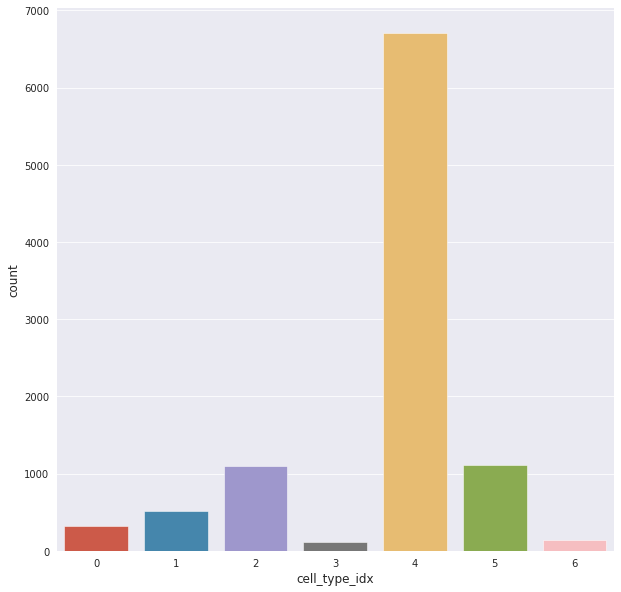

In [ ]:
plt.figure(figsize = (10,10))
sns.set_style("darkgrid")
sns.countplot(Label)

## **Resampling dataset agar dataset menjadi seimbang.**

In [ ]:
oversample = RandomOverSampler()
Data,Label  = oversample.fit_resample(Data,Label)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


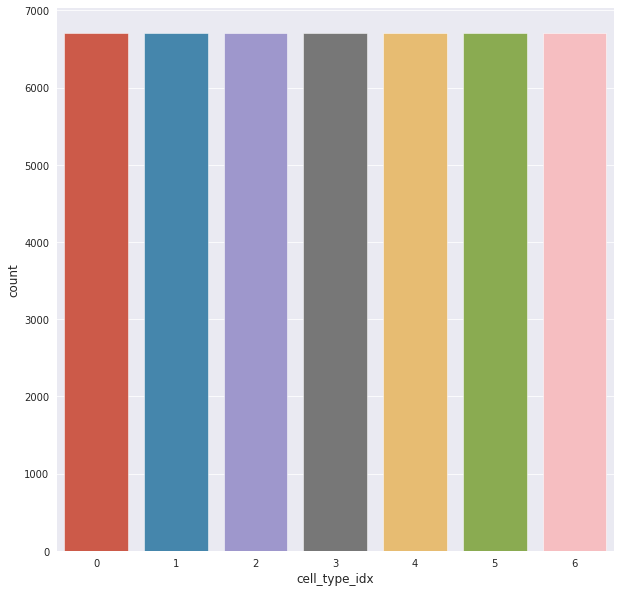

In [ ]:
plt.figure(figsize = (10,10))
sns.set_style("darkgrid")
sns.countplot(Label)

In [ ]:
Label = np.array(Label)
Label

array([2, 2, 2, ..., 6, 6, 6], dtype=int8)

In [ ]:
classes = {4: ('nv', ' melanocytic nevi'),
           6: ('mel', 'melanoma'),
           2 :('bkl', 'benign keratosis-like lesions'), 
           1:('bcc' , ' basal cell carcinoma'),
           5: ('vasc', ' pyogenic granulomas and hemorrhage'),
           0: ('akiec', 'Actinic keratoses and intraepithelial carcinomae'),
           3: ('df', 'dermatofibroma')}

# **Splitting Data**

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(imgs, target, test_size=0.01)
x_train, x_val, y_train, y_val = train_test_split(imgs, target, test_size=0.19)

train_val_test = (x_train, y_train, x_val, y_val, x_test, y_test)

[x_train.shape, x_val.shape, x_test.shape , y_train.shape , y_val.shape , y_test.shape]

[(8112, 32, 32, 3),
 (1903, 32, 32, 3),
 (101, 32, 32, 3),
 (8112,),
 (1903,),
 (101,)]

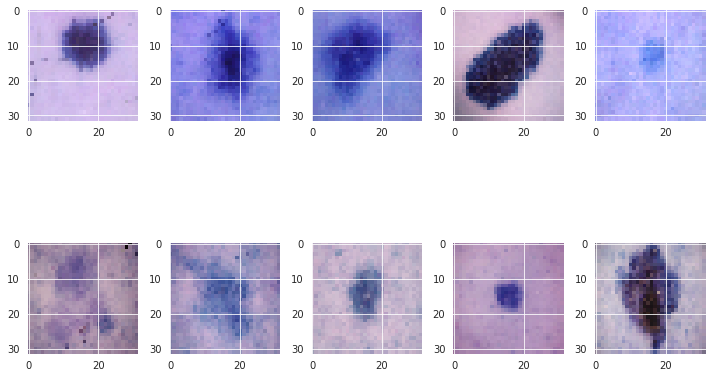

In [ ]:
f , ax = plt.subplots(2,5)
f.set_size_inches(10, 10)
k = 0 
for i in range(2):
    for j in range(5):
        ax[i,j].imshow(x_train[k].reshape(32,32,3))
        k = k + 1
    plt.tight_layout()

In [ ]:
y_train = to_categorical(y_train)
y_val = to_categorical(y_val)
y_test = to_categorical(y_test)

In [ ]:
print(y_train)

[[0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 1. 0. 0.]
 ...
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 1. 0. 0.]
 [0. 0. 0. ... 1. 0. 0.]]


# **Pre-Processing**

**Melakukan augmentasi data menggunakan teknik image processing seperti (random noise, clahe, usuyama, blur, atau yang lainnya) dan ImageDataGenerator**

In [ ]:
from matplotlib import pyplot as plt
import numpy as np
import argparse
import cv2

In [ ]:
def plt_imshow(title, image):
	image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
	plt.imshow(image)
	plt.title(title)
	plt.grid(False)
	plt.show()

In [ ]:
args = {
	"image": "/content/ISIC_0028484.jpeg"
}

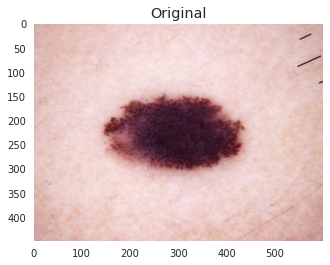

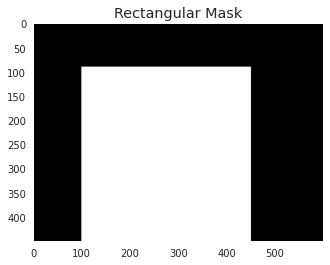

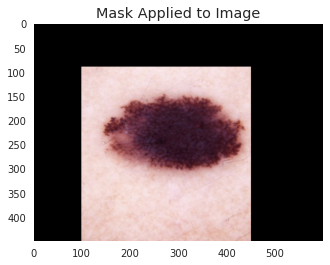

In [ ]:
image = cv2.imread(args["image"])
plt_imshow("Original", image)
mask = np.zeros(image.shape[:2], dtype="uint8")
cv2.rectangle(mask, (100, 90), (450, 500), 255, -1)
plt_imshow("Rectangular Mask", mask)

masked = cv2.bitwise_and(image, image, mask=mask)
plt_imshow("Mask Applied to Image", masked)

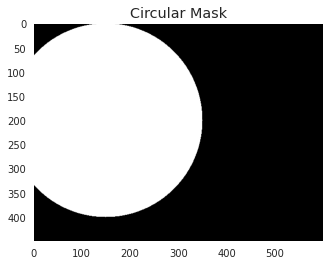

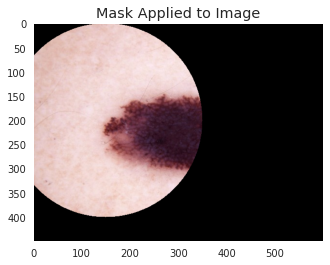

In [ ]:
mask = np.zeros(image.shape[:2], dtype="uint8")
cv2.circle(mask, (150, 200), 200, 255, -1)
masked = cv2.bitwise_and(image, image, mask=mask)

plt_imshow("Circular Mask", mask)
plt_imshow("Mask Applied to Image", masked)

In [ ]:
datagen = ImageDataGenerator(rescale=(1./255)
                             ,rotation_range=10
                             ,zoom_range = 0.1
                             ,width_shift_range=0.1
                             ,height_shift_range=0.1)
testgen = ImageDataGenerator(rescale=(1./255))

# **MODEL -1**

**Model pertama menggabungkan minimal 2 kombinasi pretrained architectures yang berbeda sebagai ekstraksi fitur. Training pembobotan dilakukan pada layer eksperiment dengan menerapkan improvisasi training pada modul sebelumnya.**

In [ ]:
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy'
                                            , patience = 2
                                            , verbose=1
                                            ,factor=0.5
                                            , min_lr=0.0001
                                            , decay=0.001/32 )

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout, Input, GlobalMaxPooling2D, concatenate
from tensorflow.keras.applications import Xception, ResNet50V2, EfficientNetB5, VGG16
from tensorflow.keras.optimizers import Adam

In [ ]:
inputan = (32,32,3)
input_model = Input(shape=inputan)

rn50v2 = ResNet50V2(include_top=False, weights="imagenet", input_shape=inputan)(input_model)
enb5= EfficientNetB5(include_top=False, weights="imagenet", input_shape=inputan)(input_model)


def pemodelan(m1,m2):
  model = concatenate([m1,m2])
  model = GlobalMaxPooling2D()(model)
  model = Flatten(name="flatten")(model)
  model = Dense(2048, activation="relu")(model)
  model = Dropout(0.35)(model)
  model = Dense(1024, activation="relu")(model)
  model = Dropout(0.35)(model)
  model = Dense(7, activation="softmax")(model)

  return model

115277824/115263384 [==============================] - 3s 0us/step


In [ ]:
model1= pemodelan(rn50v2,enb5)
pemodelan_1 = Model(inputs=input_model, outputs=model1)
pemodelan_1.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 32, 32, 3)]  0           []                               
                                                                                                  
 resnet50v2 (Functional)        (None, 1, 1, 2048)   23564800    ['input_1[0][0]']                
                                                                                                  
 efficientnetb5 (Functional)    (None, 1, 1, 2048)   28513527    ['input_1[0][0]']                
                                                                                                  
 concatenate (Concatenate)      (None, 1, 1, 4096)   0           ['resnet50v2[0][0]',             
                                                                  'efficientnetb5[0][0]']     

In [ ]:
rn50v2.trainable = False
enb5.trainable = False

In [ ]:
import tensorflow as tf
tensorboard=tf.keras.callbacks.TensorBoard(log_dir='./logs/aug')

In [ ]:
%load_ext tensorboard

In [ ]:
!rm -rf ./logs/aug

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
def callback(path):
  checkpoint_callback = ModelCheckpoint(path,
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)
  reduce_callback = ReduceLROnPlateau(monitor='val_accuracy', patience=3, factor=0.5, min_lr=0.0001, verbose=1)
  callbacks_list = [checkpoint_callback, reduce_callback]
  return callbacks_list

In [ ]:
best_model_path = 'model1.h5'
cb=callback(best_model_path)

In [ ]:
learning_rate=0.0001
pemodelan_1.compile(optimizer=Adam(lr=learning_rate), 
                    loss = keras.losses.CategoricalCrossentropy(),
                    metrics = ['accuracy'])

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [ ]:
history = pemodelan_1.fit(x_train ,
                    y_train ,
                    epochs=150 ,
                    batch_size=128,
                    validation_data=(x_test , y_test) ,
                    callbacks=[tensorboard,cb])

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


Epoch 1/150
64/64 [==============================] - ETA: 0s - loss: 1.1228 - accuracy: 0.6516
Epoch 00001: val_accuracy improved from -inf to 0.66337, saving model to model1.h5
64/64 [==============================] - 99s 766ms/step - loss: 1.1228 - accuracy: 0.6516 - val_loss: 1.4772 - val_accuracy: 0.6634 - lr: 1.0000e-04
Epoch 2/150
64/64 [==============================] - ETA: 0s - loss: 0.9024 - accuracy: 0.6857
Epoch 00002: val_accuracy did not improve from 0.66337
64/64 [==============================] - 29s 448ms/step - loss: 0.9024 - accuracy: 0.6857 - val_loss: 1.7773 - val_accuracy: 0.6634 - lr: 1.0000e-04
Epoch 3/150
64/64 [==============================] - ETA: 0s - loss: 0.8186 - accuracy: 0.7117
Epoch 00003: val_accuracy did not improve from 0.66337
64/64 [==============================] - 28s 444ms/step - loss: 0.8186 - accuracy: 0.7117 - val_loss: 1.0527 - val_accuracy: 0.6634 - lr: 1.0000e-04
Epoch 4/150
64/64 [==============================] - ETA: 0s - loss: 0.7356

In [ ]:
pemodelan_1.evaluate(x_test , y_test)

4/4 [==============================] - 3s 470ms/step - loss: 0.6275 - accuracy: 0.8713


[0.6275449991226196, 0.8712871074676514]

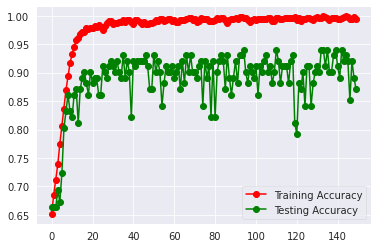

In [ ]:
plt.plot(history.history["accuracy"] , 'ro-' , label = "Training Accuracy")
plt.plot(history.history["val_accuracy"] , 'go-' , label = "Testing Accuracy")
plt.legend()
plt.show()

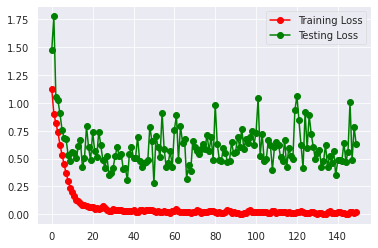

In [ ]:
plt.plot(history.history["loss"] , 'ro-' , label = "Training Loss")
plt.plot(history.history["val_loss"] , 'go-' , label = "Testing Loss")
plt.legend()
plt.show()

**Membuat evaluasi model berupa plot nilai akurasi dan loss, metric akurasi, f-measure, recall, presisi, dan confusion matrix.**

In [ ]:
y_pred  = pemodelan_1.predict(x_test).round()

In [ ]:
target_names = [f"{classes[i]}" for i in range(7)]
print(classification_report(y_test , y_pred , target_names =target_names ))

                                                               precision    recall  f1-score   support

('akiec', 'Actinic keratoses and intraepithelial carcinomae')       0.67      0.67      0.67         3
                             ('bcc', ' basal cell carcinoma')       0.75      0.43      0.55         7
                     ('bkl', 'benign keratosis-like lesions')       1.00      0.67      0.80        12
                                     ('df', 'dermatofibroma')       1.00      1.00      1.00         2
                                  ('nv', ' melanocytic nevi')       0.90      0.96      0.93        67
              ('vasc', ' pyogenic granulomas and hemorrhage')       0.67      0.75      0.71         8
                                          ('mel', 'melanoma')       0.67      1.00      0.80         2

                                                    micro avg       0.87      0.86      0.87       101
                                                    macro avg       0.8

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1308: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


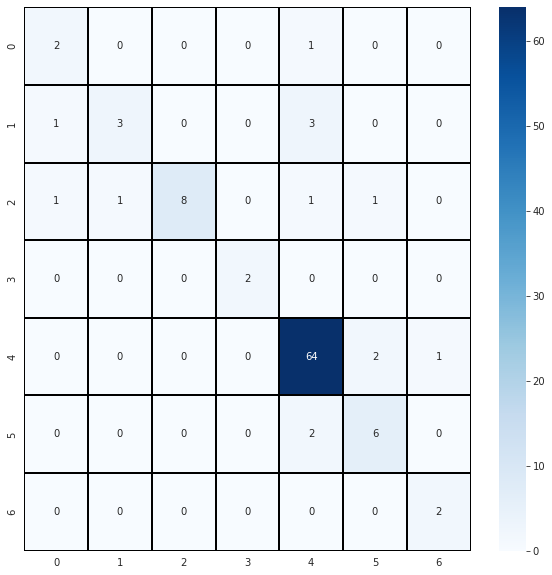

In [ ]:
cm = confusion_matrix(y_test.argmax(axis = 1) , y_pred.argmax(axis = 1))
cm = pd.DataFrame(cm , index = [i for i in range(7)] , columns = [i for i in range(7)])
plt.figure(figsize = (10,10))
sns.heatmap(cm,cmap= "Blues", linecolor = 'black' , linewidth = 1 , annot = True, fmt='')

**Prediksi 10 gambar acak**

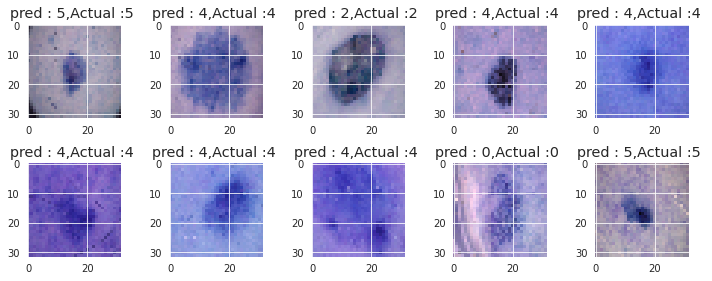

In [ ]:
ncolu = 5
nrow = 2
fig = plt.gcf()
fig.set_size_inches(ncolu*2,nrow*2)
correct = np.nonzero(y_pred == y_test)[0]

k = 0 
for c in correct[:10]:
            plt.subplot(2,5,k+1)
            plt.imshow(x_test[k].reshape(32,32,3) , interpolation='none')
            plt.title(f"pred : {y_pred[k].argmax(axis = 0)},Actual :{y_test[k].argmax(axis = 0)} ")
            plt.tight_layout()
            k += 1

**Menyimpan semua model dalam format tflite**

In [ ]:
converter_model = tf.lite.TFLiteConverter.from_keras_model(pemodelan_1) 
tflite_model = converter_model.convert()

INFO:tensorflow:Assets written to: /tmp/tmp96obaqk4/assets


In [ ]:
with open('model1.tflite', 'wb') as f: 
  f.write(tflite_model)

**Melakukan ujicoba model dengan menerapkan materi pada modul-modul sebelumnya. (regularization, hiperparameter tuning, lr scheduler, dll)**

In [ ]:
import os
import cv2
import numpy as np
import tensorflow as tf
from time import time
from tensorflow.keras import utils
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPool2D, BatchNormalization, Dropout, MaxPooling2D, GlobalMaxPooling2D, concatenate
from tensorflow.keras.applications import Xception, ResNet50V2, EfficientNetB5
from tensorboard.plugins.hparams import api as hp
from sklearn.model_selection import train_test_split
from keras.callbacks import ReduceLROnPlateau
from keras.models import Sequential
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import tensorflow as tf
tensorboard=tf.keras.callbacks.TensorBoard(log_dir='./logs/aug')

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
!rm -rf ./logs/aug

In [ ]:
HP_DROPOUT = hp.HParam('dropout', hp.RealInterval(0.2, 0.5))
HP_OPTIMIZER = hp.HParam('optimizer', hp.Discrete(['adam', 'sgd']))

METRIC_ACCURACY = 'accuracy'

hparam_summary_dir = '/content'


In [ ]:
first_mine_model_dict = dict()
first_mine_history_dict = dict()

In [ ]:
from tensorflow.keras.layers import InputLayer
from tensorflow.keras.models import Model

def train_test_first_model(hparams, session_num):
    global first_mine_model_dict
    global first_mine_history_dict

    model = Sequential()

    model.add(ResNet50V2(weights='imagenet', include_top=False, input_shape=(32,32,3)))
    model.add(Flatten())
    model.add(Dropout(hparams[HP_DROPOUT]))
    model.add(Dense(7, activation='softmax'))

    model.compile(
        optimizer=hparams[HP_OPTIMIZER],
        loss='CategoricalCrossentropy',
        metrics='accuracy'
    )

    H = model.fit(x_train, y_train,
              epochs=15,
              batch_size=128,
              validation_data=(x_val, y_val),
              callbacks=[learning_rate_reduction]
              )
    
    first_mine_model_dict[session_num] = model
    first_mine_history_dict[session_num] = H.history

    _, accuracy = model.evaluate(x_test, y_test)

    return accuracy


In [ ]:
def first_model_run(run_dir, hparams, session_num):
    with tf.summary.create_file_writer(run_dir).as_default():
        hp.hparams(hparams)
        accuracy = train_test_first_model(hparams, session_num)
        tf.summary.scalar(METRIC_ACCURACY, accuracy, step=50)

In [ ]:
session_num = 0

for dropout_rate in (HP_DROPOUT.domain.min_value, HP_DROPOUT.domain.max_value):
  for optimizer in HP_OPTIMIZER.domain.values:
    hparams = {
        HP_DROPOUT: dropout_rate,
        HP_OPTIMIZER: optimizer,
    }
    run_name = "run-%d" % session_num
    print('--- Starting trial: %s' % run_name)
    print({h.name: hparams[h] for h in hparams})

    first_model_run('logs/hparam_tuning/' + run_name, hparams, session_num)
    session_num += 1

--- Starting trial: run-0
{'dropout': 0.2, 'optimizer': 'adam'}
Epoch 1/15
64/64 [==============================] - 18s 186ms/step - loss: 1.0595 - accuracy: 0.6614 - val_loss: 6.5580 - val_accuracy: 0.6726 - lr: 0.0010
Epoch 2/15
64/64 [==============================] - 10s 164ms/step - loss: 0.8519 - accuracy: 0.7191 - val_loss: 192.7334 - val_accuracy: 0.6731 - lr: 0.0010
Epoch 3/15
64/64 [==============================] - 10s 159ms/step - loss: 0.8838 - accuracy: 0.7235 - val_loss: 2.3394 - val_accuracy: 0.6921 - lr: 0.0010
Epoch 4/15
64/64 [==============================] - 10s 162ms/step - loss: 0.7849 - accuracy: 0.7371 - val_loss: 1.2415 - val_accuracy: 0.6406 - lr: 0.0010
Epoch 5/15
64/64 [==============================] - ETA: 0s - loss: 0.7373 - accuracy: 0.7527
Epoch 00005: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
64/64 [==============================] - 10s 157ms/step - loss: 0.7373 - accuracy: 0.7527 - val_loss: 1.0352 - val_accuracy: 0.6432 - lr

In [ ]:
%tensorboard --logdir logs/hparam_tuning

<IPython.core.display.Javascript object>

# **MODEL- 2**

**Model kedua menggunakan sebuah pretrained model bebas dengan improvisasi anda sendiri. Anda dapat menggunakan improvisasi pada modul sebelumnya dengan menggunakan dropout, regulizer, early stopping, callback training, grid search, dsb.**

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout, Input, GlobalAveragePooling2D, concatenate, BatchNormalization
from tensorflow.keras.applications import Xception, ResNet50V2, EfficientNetB5, VGG16
from tensorflow.keras.optimizers import Adam

In [ ]:
inputan = (32,32,3)
input_model = Input(shape=inputan)

rn50v2 = ResNet50V2(include_top=False, weights="imagenet", input_shape=inputan)(input_model)
enb5= EfficientNetB5(include_top=False, weights="imagenet", input_shape=inputan)(input_model)


def pemodelan2(m1,m2):
  model2 = concatenate([m1,m2])
  model2 = GlobalAveragePooling2D()(model2)
  model2 = Flatten(name="flatten")(model2)
  model2 = Dense(2048, activation="relu")(model2)
  model2 = Dropout(0.25)(model2)
  model2 = BatchNormalization()(model2)
  model2 = Dense(1024, activation="relu")(model2)
  model2 = Dropout(0.25)(model2)
  model2 = BatchNormalization()(model2)
  model2 = Dense(7, activation="softmax")(model2)

  return model2

In [ ]:
model_2= pemodelan2(rn50v2,enb5)
pemodelan_2 = Model(inputs=input_model, outputs=model_2)
pemodelan_2.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_8 (InputLayer)           [(None, 32, 32, 3)]  0           []                               
                                                                                                  
 resnet50v2 (Functional)        (None, 1, 1, 2048)   23564800    ['input_8[0][0]']                
                                                                                                  
 efficientnetb5 (Functional)    (None, 1, 1, 2048)   28513527    ['input_8[0][0]']                
                                                                                                  
 concatenate_1 (Concatenate)    (None, 1, 1, 4096)   0           ['resnet50v2[0][0]',             
                                                                  'efficientnetb5[0][0]']   

In [ ]:
rn50v2.trainable = False
enb5.trainable = False

In [ ]:
import tensorflow as tf
tensorboard=tf.keras.callbacks.TensorBoard(log_dir='./logs/aug')

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
!rm -rf ./logs/aug

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
def callback(path):
  checkpoint_callback = ModelCheckpoint(path,
                                      monitor='val_accuracy',
                                      save_best_only=True,
                                      verbose=1)
  reduce_callback = ReduceLROnPlateau(monitor='val_accuracy', patience=3, factor=0.5, min_lr=0.0001, verbose=1)
  callbacks_list = [checkpoint_callback, reduce_callback]
  return callbacks_list

In [ ]:
best_model_path = 'model2.h5'
cb=callback(best_model_path)

In [ ]:
learning_rate=0.0001
pemodelan_2.compile(optimizer=Adam(lr=learning_rate), 
                    loss = keras.losses.CategoricalCrossentropy(),
                    metrics = ['accuracy'])

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


In [ ]:
history2 = pemodelan_2.fit(x_train ,
                    y_train ,
                    epochs=150 ,
                    batch_size=128,
                    validation_data=(x_test , y_test) ,
                    callbacks=[tensorboard,cb])

/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


Epoch 1/150
64/64 [==============================] - ETA: 0s - loss: 2.1108 - accuracy: 0.3606
Epoch 00001: val_accuracy improved from -inf to 0.01980, saving model to model2.h5
64/64 [==============================] - 79s 677ms/step - loss: 2.1108 - accuracy: 0.3606 - val_loss: 2.1528 - val_accuracy: 0.0198 - lr: 1.0000e-04
Epoch 2/150
64/64 [==============================] - ETA: 0s - loss: 1.3891 - accuracy: 0.6520
Epoch 00002: val_accuracy improved from 0.01980 to 0.48515, saving model to model2.h5
64/64 [==============================] - 44s 696ms/step - loss: 1.3891 - accuracy: 0.6520 - val_loss: 1.7808 - val_accuracy: 0.4851 - lr: 1.0000e-04
Epoch 3/150
64/64 [==============================] - ETA: 0s - loss: 1.0871 - accuracy: 0.7053
Epoch 00003: val_accuracy improved from 0.48515 to 0.66337, saving model to model2.h5
64/64 [==============================] - 44s 691ms/step - loss: 1.0871 - accuracy: 0.7053 - val_loss: 1.2520 - val_accuracy: 0.6634 - lr: 1.0000e-04
Epoch 4/150
6

In [ ]:
pemodelan_2.evaluate(x_test , y_test)

4/4 [==============================] - 0s 105ms/step - loss: 0.4404 - accuracy: 0.9307


[0.4404340386390686, 0.9306930899620056]

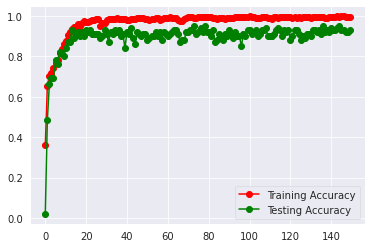

In [ ]:
plt.plot(history2.history["accuracy"] , 'ro-' , label = "Training Accuracy")
plt.plot(history2.history["val_accuracy"] , 'go-' , label = "Testing Accuracy")
plt.legend()
plt.show()

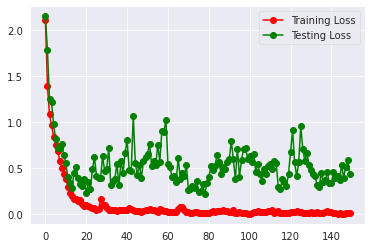

In [ ]:
plt.plot(history2.history["loss"] , 'ro-' , label = "Training Loss")
plt.plot(history2.history["val_loss"] , 'go-' , label = "Testing Loss")
plt.legend()
plt.show()

In [ ]:
y_pred  = pemodelan_2.predict(x_test).round()

In [ ]:
target_names = [f"{classes[i]}" for i in range(7)]
print(classification_report(y_test , y_pred , target_names =target_names ))

                                                               precision    recall  f1-score   support

('akiec', 'Actinic keratoses and intraepithelial carcinomae')       1.00      0.67      0.80         3
                             ('bcc', ' basal cell carcinoma')       1.00      0.86      0.92         7
                     ('bkl', 'benign keratosis-like lesions')       0.90      0.75      0.82        12
                                     ('df', 'dermatofibroma')       1.00      1.00      1.00         2
                                  ('nv', ' melanocytic nevi')       0.96      0.97      0.96        67
              ('vasc', ' pyogenic granulomas and hemorrhage')       0.73      1.00      0.84         8
                                          ('mel', 'melanoma')       1.00      1.00      1.00         2

                                                    micro avg       0.93      0.93      0.93       101
                                                    macro avg       0.9

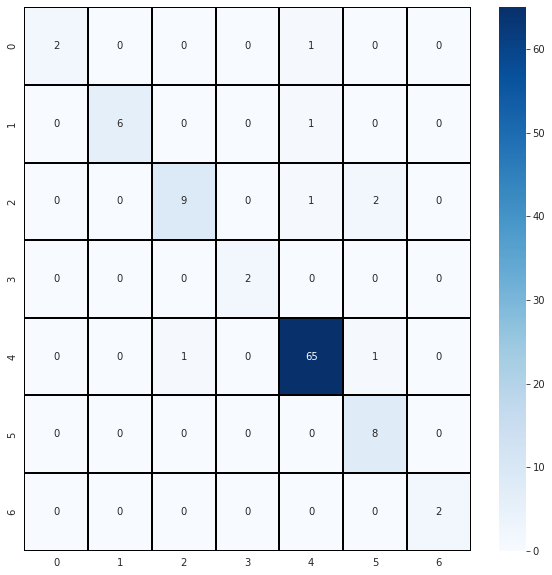

In [ ]:
cm = confusion_matrix(y_test.argmax(axis = 1) , y_pred.argmax(axis = 1))
cm = pd.DataFrame(cm , index = [i for i in range(7)] , columns = [i for i in range(7)])
plt.figure(figsize = (10,10))
sns.heatmap(cm,cmap= "Blues", linecolor = 'black' , linewidth = 1 , annot = True, fmt='')

**Membuat kode untuk melakukkan prediksi pada 10 gambar acak**

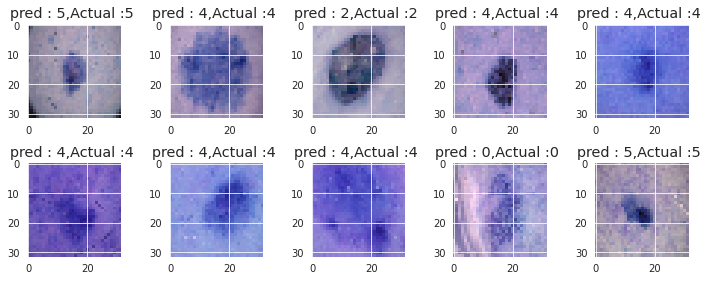

In [ ]:
ncolu = 5
nrow = 2
fig = plt.gcf()
fig.set_size_inches(ncolu*2,nrow*2)
correct = np.nonzero(y_pred == y_test)[0]

k = 0 
for c in correct[:10]:
            plt.subplot(2,5,k+1)
            plt.imshow(x_test[k].reshape(32,32,3) , interpolation='none')
            plt.title(f"pred : {y_pred[k].argmax(axis = 0)},Actual :{y_test[k].argmax(axis = 0)} ")
            plt.tight_layout()
            k += 1

In [ ]:
converter_model = tf.lite.TFLiteConverter.from_keras_model(pemodelan_2) 
tflite_model = converter_model.convert()

with open('model2.tflite', 'wb') as f: 
  f.write(tflite_model)

INFO:tensorflow:Assets written to: /tmp/tmpzrwqq3aw/assets


INFO:tensorflow:Assets written to: /tmp/tmpzrwqq3aw/assets


In [ ]:
import os
import cv2
import numpy as np
import tensorflow as tf
from time import time
from tensorflow.keras import utils
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPool2D, BatchNormalization, Dropout, MaxPooling2D, GlobalMaxPooling2D, concatenate
from tensorflow.keras.applications import Xception, ResNet50V2, EfficientNetB5, VGG16
from tensorboard.plugins.hparams import api as hp
from sklearn.model_selection import train_test_split
from keras.callbacks import ReduceLROnPlateau
from keras.models import Sequential
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import tensorflow as tf
tensorboard=tf.keras.callbacks.TensorBoard(log_dir='./logs/aug')

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
!rm -rf ./logs/aug

In [ ]:
HP_DROPOUT = hp.HParam('dropout', hp.RealInterval(0.5, 0.7))
HP_OPTIMIZER = hp.HParam('optimizer', hp.Discrete(['adam', 'RMSprop']))

METRIC_ACCURACY = 'accuracy'

hparam_summary_dir = '/content'


In [ ]:
second_mine_model_dict = dict()
second_mine_history_dict = dict()

In [ ]:
from tensorflow.keras.layers import InputLayer
from tensorflow.keras.models import Model

def train_test_second_model(hparams, session_num):
    global second_mine_model_dict
    global second_mine_history_dict

    model2 = Sequential()

    model2.add(ResNet50V2(weights='imagenet', include_top=False, input_shape=(32,32,3)))
    model2.add(Flatten())
    model2.add(Dropout(hparams[HP_DROPOUT]))
    model2.add(Dense(7, activation='softmax'))

    model2.compile(
        optimizer=hparams[HP_OPTIMIZER],
        loss='CategoricalCrossentropy',
        metrics='accuracy'
    )

    H = model2.fit(x_train, y_train,
              epochs=15,
              batch_size=128,
              validation_data=(x_val, y_val),
              callbacks=[learning_rate_reduction]
              )
    
    # Gather Model and History
    second_mine_model_dict[session_num] = model2
    second_mine_history_dict[session_num] = H.history

    _, accuracy = model2.evaluate(x_test, y_test)

    return accuracy


In [ ]:
def second_model_run(run_dir, hparams, session_num):
    with tf.summary.create_file_writer(run_dir).as_default():
        hp.hparams(hparams)
        accuracy = train_test_second_model(hparams, session_num)
        tf.summary.scalar(METRIC_ACCURACY, accuracy, step=50)

In [ ]:
session_num = 0

for dropout_rate in (HP_DROPOUT.domain.min_value, HP_DROPOUT.domain.max_value):
  for optimizer in HP_OPTIMIZER.domain.values:
    hparams = {
        HP_DROPOUT: dropout_rate,
        HP_OPTIMIZER: optimizer,
    }
    run_name = "run-%d" % session_num
    print('--- Starting trial: %s' % run_name)
    print({h.name: hparams[h] for h in hparams})

    second_model_run('logs/hparam_tuning2/' + run_name, hparams, session_num)
    session_num += 1

--- Starting trial: run-0
{'dropout': 0.5, 'optimizer': 'RMSprop'}
Epoch 1/15
64/64 [==============================] - 26s 217ms/step - loss: 1.4072 - accuracy: 0.6233 - val_loss: 7.9331 - val_accuracy: 0.6726 - lr: 0.0010
Epoch 2/15
64/64 [==============================] - 13s 199ms/step - loss: 1.1400 - accuracy: 0.6667 - val_loss: 192.4489 - val_accuracy: 0.5302 - lr: 0.0010
Epoch 3/15
64/64 [==============================] - 13s 200ms/step - loss: 1.0658 - accuracy: 0.6702 - val_loss: 20.7092 - val_accuracy: 0.6747 - lr: 0.0010
Epoch 4/15
64/64 [==============================] - 13s 200ms/step - loss: 0.9944 - accuracy: 0.6785 - val_loss: 3.7671 - val_accuracy: 0.5187 - lr: 0.0010
Epoch 5/15
64/64 [==============================] - ETA: 0s - loss: 0.9322 - accuracy: 0.6875
Epoch 00005: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
64/64 [==============================] - 13s 198ms/step - loss: 0.9322 - accuracy: 0.6875 - val_loss: 537.2781 - val_accuracy: 0.661

In [ ]:
%tensorboard --logdir logs/hparam_tuning2

<IPython.core.display.Javascript object>

**Contoh prediksi 10 gambar baru**

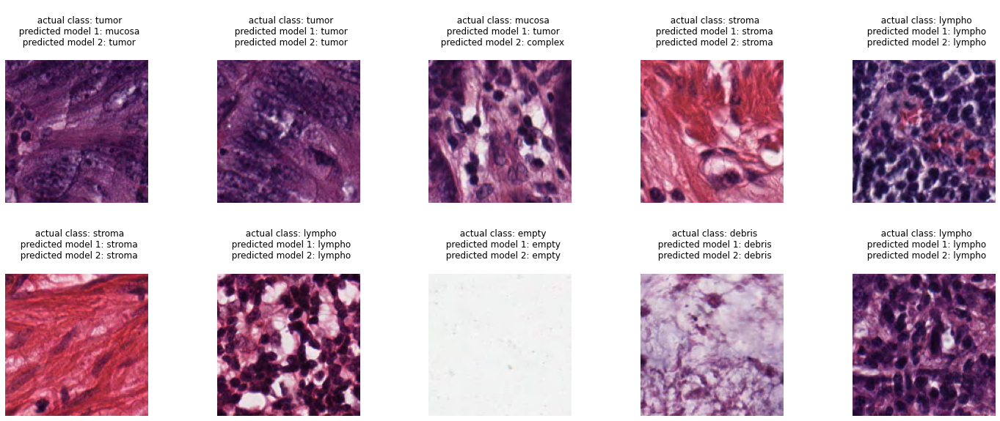